Mounted at /content/drive
Found 110 puzzles.


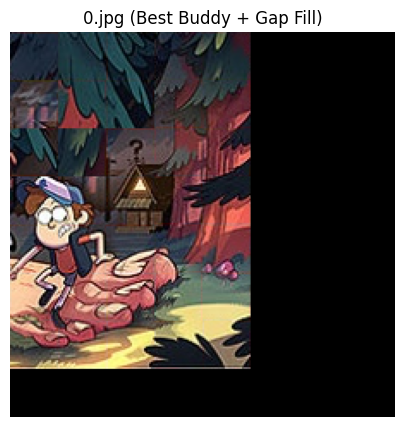

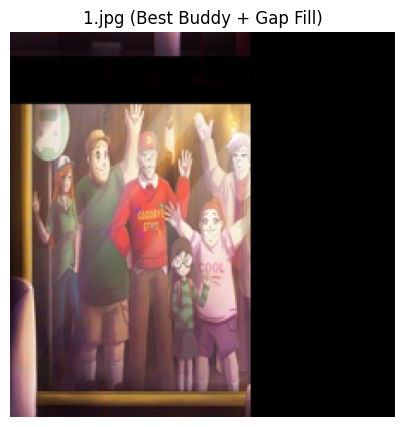

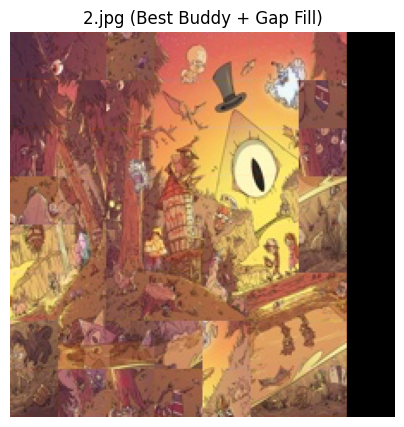

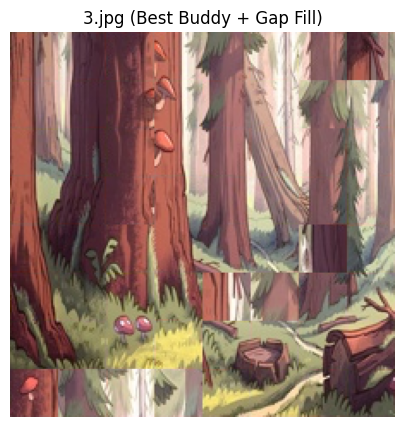

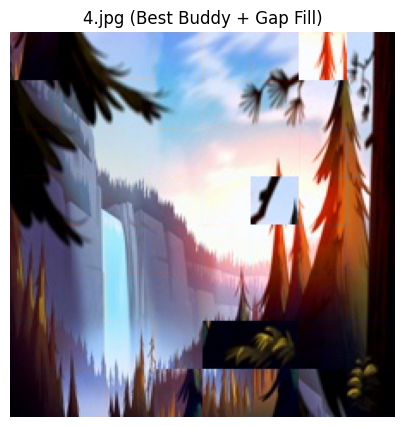

...

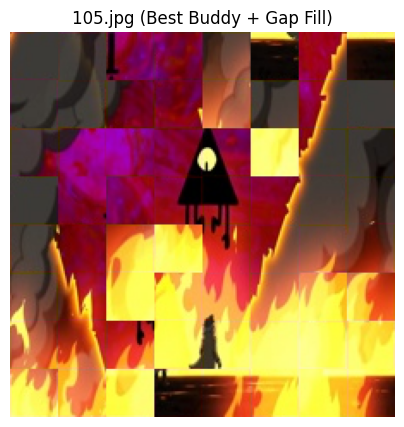

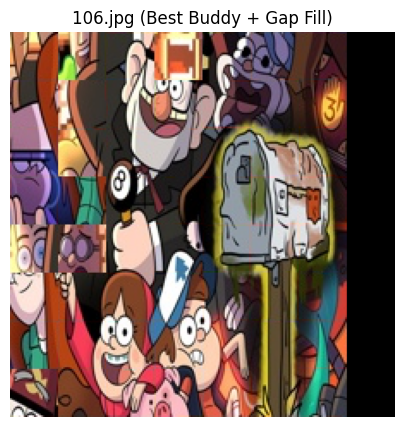

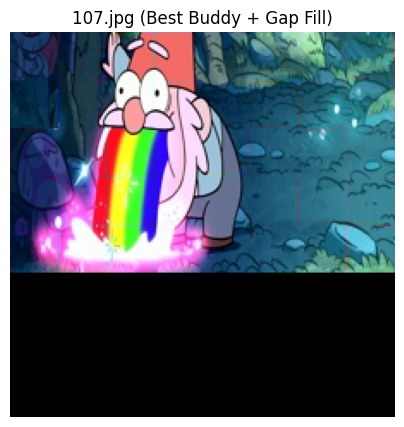

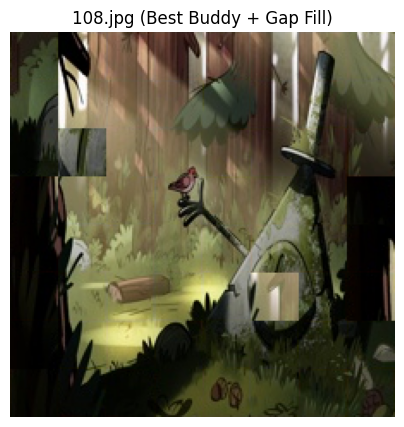

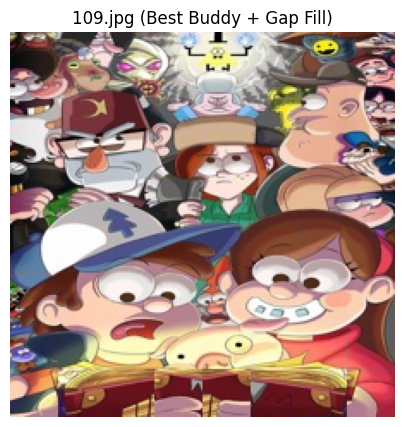

In [1]:
# =========================================================
# 1. SETUP & IMPORTS
# =========================================================
import cv2
import numpy as np
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import random
from google.colab import drive

# Mount Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

base_path = "/content/drive/MyDrive/Gravity Falls/puzzle_8x8/"

# =========================================================
# 2. ADVANCED LOGIC: BEST BUDDY + ROBUST MERGE
# =========================================================

class PuzzleGroup:
    def __init__(self, piece_id):
        # Maps relative (r, c) -> piece_id
        self.placements = {(0, 0): piece_id}
        # Keep track of bounding box to ensure 8x8 limit
        self.min_r, self.max_r = 0, 0
        self.min_c, self.max_c = 0, 0
        self.id = piece_id

    def size(self):
        return len(self.placements)

    def can_merge(self, other_group, offset_r, offset_c):
        """Checks if merging breaks the 8x8 limit or causes overlap."""
        # 1. Check Dimensions
        new_min_r = min(self.min_r, other_group.min_r + offset_r)
        new_max_r = max(self.max_r, other_group.max_r + offset_r)
        new_min_c = min(self.min_c, other_group.min_c + offset_c)
        new_max_c = max(self.max_c, other_group.max_c + offset_c)

        if (new_max_r - new_min_r + 1) > 8: return False
        if (new_max_c - new_min_c + 1) > 8: return False

        # 2. Check Overlap
        for (r, c) in other_group.placements:
            if (r + offset_r, c + offset_c) in self.placements:
                return False
        return True

    def merge(self, other_group, offset_r, offset_c):
        """Merges other_group into this one."""
        for (r, c), pid in other_group.placements.items():
            new_r, new_c = r + offset_r, c + offset_c
            self.placements[(new_r, new_c)] = pid

        self.min_r = min(self.min_r, other_group.min_r + offset_r)
        self.max_r = max(self.max_r, other_group.max_r + offset_r)
        self.min_c = min(self.min_c, other_group.min_c + offset_c)
        self.max_c = max(self.max_c, other_group.max_c + offset_c)

def calculate_costs_and_buddies(lab_pieces):
    """
    1. Calculates pairwise costs.
    2. Identifies 'Best Buddies' (Mutual Best Matches).
    Returns a sorted list of edges with Buddies prioritized.
    """
    n = len(lab_pieces)
    rights  = np.array([p[:, -1, :] for p in lab_pieces])
    lefts   = np.array([p[:, 0, :] for p in lab_pieces])
    bottoms = np.array([p[-1, :, :] for p in lab_pieces])
    tops    = np.array([p[0, :, :] for p in lab_pieces])

    # Cost Matrices
    # H_cost[i, j] = Cost if i is Left of j
    H_cost = np.zeros((n, n))
    V_cost = np.zeros((n, n))

    for i in range(n):
        for j in range(n):
            if i == j:
                H_cost[i,j] = V_cost[i,j] = float('inf')
                continue
            H_cost[i,j] = np.sum((rights[i] - lefts[j])**2)
            V_cost[i,j] = np.sum((bottoms[i] - tops[j])**2)

    edges = []

    # Helper to find if (u, v) is a Best Buddy pair
    def is_best_buddy(u, v, cost_matrix, reverse_matrix=None):
        # Forward: v is best neighbor for u
        best_fwd = np.argmin(cost_matrix[u, :])
        # Backward: u is best neighbor for v (in opposite direction)
        # If horizontal: u is Left of v, so v is Right of u (uses same matrix but swapped indices implies logic check)
        # Actually simpler:
        # If u->v is Best Horizontal, is v->u Best Horizontal "Incoming"?
        # i.e. is u the best 'Left' for v?
        best_bwd = np.argmin(cost_matrix[:, v])
        return (v == best_fwd) and (u == best_bwd)

    # Build Edge List
    for u in range(n):
        for v in range(n):
            if u == v: continue

            # Horizontal Edge (u | v)
            cost_h = H_cost[u, v]
            buddy_h = is_best_buddy(u, v, H_cost)
            # Prioritize Buddies by giving negative cost
            prio_h = -1000000 if buddy_h else cost_h
            edges.append((prio_h, u, v, 0)) # 0 = Horizontal

            # Vertical Edge (u / v)
            cost_v = V_cost[u, v]
            # Check vertical buddy: u is Top of v, implies u is best Top for v, v is best Bottom for u
            best_bot_for_u = np.argmin(V_cost[u, :])
            best_top_for_v = np.argmin(V_cost[:, v])
            buddy_v = (v == best_bot_for_u) and (u == best_top_for_v)

            prio_v = -1000000 if buddy_v else cost_v
            edges.append((prio_v, u, v, 1)) # 1 = Vertical

    edges.sort(key=lambda x: x[0])
    return edges, H_cost, V_cost

def fill_holes(main_group, unused_pieces, H_cost, V_cost):
    """
    Fills the black voids (None slots) in the main group using remaining pieces.
    """
    # 1. Define the grid bounds
    rows = main_group.max_r - main_group.min_r + 1
    cols = main_group.max_c - main_group.min_c + 1

    # Create a grid representation
    grid = np.full((rows, cols), -1, dtype=int)
    for (r, c), pid in main_group.placements.items():
        grid[r - main_group.min_r, c - main_group.min_c] = pid

    # 2. Identify Empty Slots
    empty_slots = []
    for r in range(rows):
        for c in range(cols):
            if grid[r, c] == -1:
                empty_slots.append((r, c))

    unused = list(unused_pieces)

    # 3. Fill iteratively
    # We loop until all slots filled or no pieces left
    while empty_slots and unused:
        best_slot_idx = -1
        best_piece_idx = -1
        best_score = float('inf')

        # Find the best piece for any empty slot
        for s_idx, (r, c) in enumerate(empty_slots):
            # Get neighbors
            top = grid[r-1, c] if r > 0 else -1
            bot = grid[r+1, c] if r < rows-1 else -1
            left = grid[r, c-1] if c > 0 else -1
            right = grid[r, c+1] if c < cols-1 else -1

            for p_idx, pid in enumerate(unused):
                score = 0
                count = 0
                if top != -1: score += V_cost[top, pid]; count += 1
                if bot != -1: score += V_cost[pid, bot]; count += 1
                if left != -1: score += H_cost[left, pid]; count += 1
                if right != -1: score += H_cost[pid, right]; count += 1

                if count > 0:
                    avg_score = score / count
                    if avg_score < best_score:
                        best_score = avg_score
                        best_slot_idx = s_idx
                        best_piece_idx = p_idx

        if best_slot_idx != -1:
            # Place the piece
            r, c = empty_slots.pop(best_slot_idx)
            pid = unused.pop(best_piece_idx)
            grid[r, c] = pid

            # Update the main group object so we can render it later
            # (Convert back to relative coordinates of the group)
            rel_r = r + main_group.min_r
            rel_c = c + main_group.min_c
            main_group.placements[(rel_r, rel_c)] = pid
        else:
            break # No valid moves left (shouldn't happen in 8x8)

def solve_puzzle_robust(pieces):
    # 1. LAB Conversion
    lab_pieces = [cv2.cvtColor(p, cv2.COLOR_RGB2LAB).astype("float32") for p in pieces]

    # 2. Get Sorted Edges (Buddies First)
    edges, H_cost, V_cost = calculate_costs_and_buddies(lab_pieces)

    # 3. Initialize Groups
    groups = {i: PuzzleGroup(i) for i in range(len(pieces))}
    group_lookup = {i: i for i in range(len(pieces))}

    # 4. Merge Loop
    for cost, u, v, relation in edges:
        u_gid = group_lookup[u]
        v_gid = group_lookup[v]
        if u_gid == v_gid: continue

        group_u = groups[u_gid]
        group_v = groups[v_gid]

        # Determine Alignment
        u_loc = [k for k, val in group_u.placements.items() if val == u][0]
        v_loc = [k for k, val in group_v.placements.items() if val == v][0]

        if relation == 0: # Horizontal (u | v)
            target_v_r, target_v_c = u_loc[0], u_loc[1] + 1
        else: # Vertical (u / v)
            target_v_r, target_v_c = u_loc[0] + 1, u_loc[1]

        offset_r = target_v_r - v_loc[0]
        offset_c = target_v_c - v_loc[1]

        if group_u.can_merge(group_v, offset_r, offset_c):
            group_u.merge(group_v, offset_r, offset_c)
            for pid in group_v.placements.values():
                group_lookup[pid] = u_gid
            del groups[v_gid]
            if len(groups) == 1: break

    # 5. ORPHAN RESCUE (Fixing Black Voids)
    largest_group = max(groups.values(), key=lambda g: g.size())

    # Collect all pieces NOT in the largest group
    used_pids = set(largest_group.placements.values())
    all_pids = set(range(len(pieces)))
    unused_pids = all_pids - used_pids

    if unused_pids:
        # Force fill them into the grid
        fill_holes(largest_group, unused_pids, H_cost, V_cost)

    # 6. Render
    h_tile, w_tile, _ = pieces[0].shape
    canvas = np.zeros((8 * h_tile, 8 * w_tile, 3), dtype=np.uint8)

    abs_min_r = largest_group.min_r
    abs_min_c = largest_group.min_c

    for (r, c), pid in largest_group.placements.items():
        final_r = r - abs_min_r
        final_c = c - abs_min_c
        # Safety bound check
        if 0 <= final_r < 8 and 0 <= final_c < 8:
            canvas[final_r*h_tile : (final_r+1)*h_tile, final_c*w_tile : (final_c+1)*w_tile] = pieces[pid]

    return canvas

# =========================================================
# 3. MAIN LOOP
# =========================================================
def slice_image(image):
    h, w, _ = image.shape
    d_h, d_w = h//8, w//8
    pieces = []
    for r in range(8):
        for c in range(8):
            pieces.append(image[r*d_h:(r+1)*d_h, c*d_w:(c+1)*d_w])
    return pieces

search_path = os.path.join(base_path, "*.jpg")
image_paths = sorted(glob.glob(search_path),
                     key=lambda x: int(os.path.basename(x).split('.')[0]))

print(f"Found {len(image_paths)} puzzles.")

for i, path in enumerate(image_paths):
    filename = os.path.basename(path)
    if filename.startswith("._"): continue

    original_img = cv2.imread(path)
    if original_img is None: continue
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)

    real_pieces = slice_image(original_img)
    shuffled = real_pieces.copy()
    random.seed(i)
    random.shuffle(shuffled)

    # Solve
    solved_img = solve_puzzle_robust(shuffled)

    # Visualize
    plt.figure(figsize=(5, 5))
    plt.imshow(solved_img)
    plt.title(f"{filename} (Best Buddy + Gap Fill)")
    plt.axis('off')
    plt.show()

--- JIGSAW SOLVER DEMO (8x8) ---

Processing: 0.jpg | Type: Clean Case


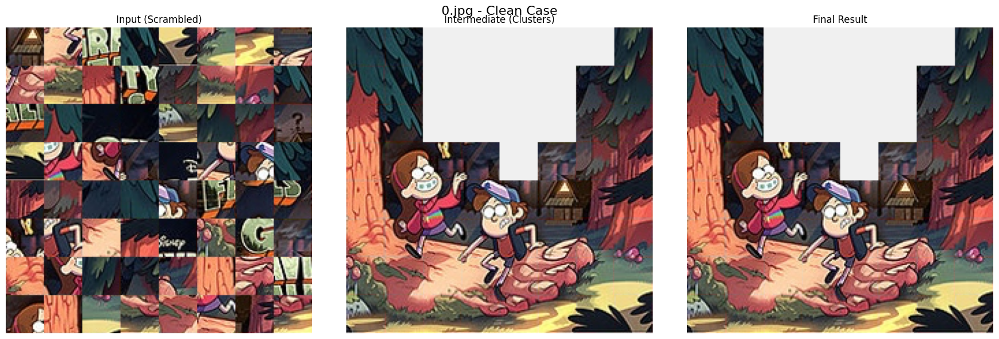

------------------------------------------------------------
Processing: 109.jpg | Type: Clean Case


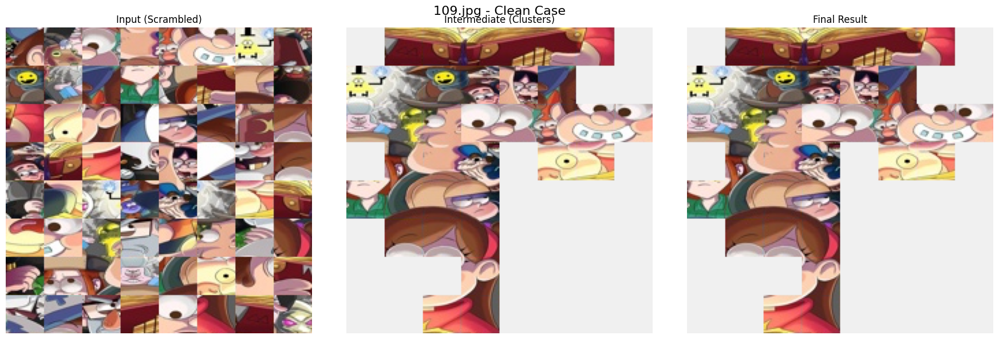

------------------------------------------------------------
Processing: 109.jpg | Type: Challenging Case (Noisy)


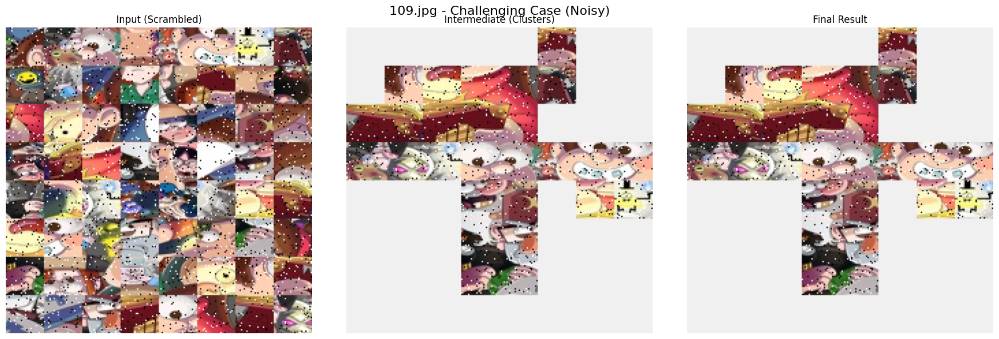

------------------------------------------------------------


In [4]:
# =========================================================
# 1. SETUP & IMPORTS
# =========================================================
import cv2
import numpy as np
import glob
import os
import matplotlib.pyplot as plt
import random
from google.colab import drive

# Mount Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

# PATH SETUP
base_path = "/content/drive/MyDrive/Gravity Falls/puzzle_8x8/"
GRID_SIZE = 8

# =========================================================
# 2. HELPER: NOISE GENERATOR (For "Challenging" Case)
# =========================================================
def add_noise(image, intensity=0.02):
    """
    Adds 'Salt and Pepper' noise to make the puzzle challenging.
    intensity: Percentage of pixels to corrupt (0.02 = 2%)
    """
    noisy = image.copy()
    h, w, c = noisy.shape
    num_pixels = int(h * w * intensity)

    # Add White spots (Salt)
    for _ in range(num_pixels):
        y = random.randint(0, h-1)
        x = random.randint(0, w-1)
        noisy[y, x] = [255, 255, 255]

    # Add Black spots (Pepper)
    for _ in range(num_pixels):
        y = random.randint(0, h-1)
        x = random.randint(0, w-1)
        noisy[y, x] = [0, 0, 0]

    return noisy

# =========================================================
# 3. CORE LOGIC WITH VISUALIZATION HOOKS
# =========================================================

class PuzzleGroup:
    def __init__(self, piece_id):
        self.placements = {(0, 0): piece_id}
        self.min_r, self.max_r = 0, 0
        self.min_c, self.max_c = 0, 0
        self.id = piece_id

    def size(self): return len(self.placements)

    def can_merge(self, other_group, offset_r, offset_c):
        new_min_r = min(self.min_r, other_group.min_r + offset_r)
        new_max_r = max(self.max_r, other_group.max_r + offset_r)
        new_min_c = min(self.min_c, other_group.min_c + offset_c)
        new_max_c = max(self.max_c, other_group.max_c + offset_c)

        if (new_max_r - new_min_r + 1) > GRID_SIZE: return False
        if (new_max_c - new_min_c + 1) > GRID_SIZE: return False

        for (r, c) in other_group.placements:
            if (r + offset_r, c + offset_c) in self.placements:
                return False
        return True

    def merge(self, other_group, offset_r, offset_c):
        for (r, c), pid in other_group.placements.items():
            self.placements[(r + offset_r, c + offset_c)] = pid
        self.min_r = min(self.min_r, other_group.min_r + offset_r)
        self.max_r = max(self.max_r, other_group.max_r + offset_r)
        self.min_c = min(self.min_c, other_group.min_c + offset_c)
        self.max_c = max(self.max_c, other_group.max_c + offset_c)

def get_edge_variance(edge_pixels):
    gray = np.mean(edge_pixels, axis=1)
    return np.var(gray)

def render_current_state(groups, pieces, h_tile, w_tile):
    """
    Renders the largest group found so far (intermediate state).
    """
    canvas_h = GRID_SIZE * h_tile
    canvas_w = GRID_SIZE * w_tile
    canvas = np.full((canvas_h, canvas_w, 3), 240, dtype=np.uint8) # Light gray bg

    if not groups: return canvas

    # Render the largest connected component
    main_group = max(groups.values(), key=lambda g: g.size())

    for (r, c), pid in main_group.placements.items():
        final_r = r - main_group.min_r
        final_c = c - main_group.min_c
        if 0 <= final_r < GRID_SIZE and 0 <= final_c < GRID_SIZE:
            canvas[final_r*h_tile : (final_r+1)*h_tile, final_c*w_tile : (final_c+1)*w_tile] = pieces[pid]

    return canvas

def solve_with_history_8x8(pieces):
    """
    Solves 8x8 puzzle and returns snapshots: [Initial, Intermediate, Final]
    """
    history = []
    h_tile, w_tile, _ = pieces[0].shape
    num_pieces = len(pieces)

    # --- SNAPSHOT 1: SCRAMBLED ---
    # Just render the pieces in order 0..63 in a grid
    scramble_canvas = np.zeros((GRID_SIZE*h_tile, GRID_SIZE*w_tile, 3), dtype=np.uint8)
    for i in range(num_pieces):
        r, c = divmod(i, GRID_SIZE)
        scramble_canvas[r*h_tile:(r+1)*h_tile, c*w_tile:(c+1)*w_tile] = pieces[i]
    history.append(("Input (Scrambled)", scramble_canvas))

    # --- CALCULATION START ---
    lab_pieces = [cv2.cvtColor(p, cv2.COLOR_RGB2LAB).astype("float32") for p in pieces]

    rights  = np.array([p[:, -1, :] for p in lab_pieces])
    lefts   = np.array([p[:, 0, :] for p in lab_pieces])
    bottoms = np.array([p[-1, :, :] for p in lab_pieces])
    tops    = np.array([p[0, :, :] for p in lab_pieces])

    H_cost = np.zeros((num_pieces, num_pieces))
    V_cost = np.zeros((num_pieces, num_pieces))

    # Variance (Texture)
    H_var = np.array([get_edge_variance(rights[i]) for i in range(num_pieces)])
    V_var = np.array([get_edge_variance(bottoms[i]) for i in range(num_pieces)])

    for i in range(num_pieces):
        for j in range(num_pieces):
            if i == j: H_cost[i,j] = V_cost[i,j] = float('inf'); continue
            H_cost[i,j] = np.sum((rights[i] - lefts[j])**2)
            V_cost[i,j] = np.sum((bottoms[i] - tops[j])**2)

    edges = []
    for u in range(num_pieces):
        for v in range(num_pieces):
            if u == v: continue

            # Best Buddy + Texture Logic
            best_h_fwd = np.argmin(H_cost[u, :])
            best_h_bwd = np.argmin(H_cost[:, v])
            is_buddy_h = (best_h_fwd == v) and (best_h_bwd == u)
            score_h = (-10000 - H_var[u]) if is_buddy_h else H_cost[u, v]
            edges.append((score_h, u, v, 0))

            best_v_fwd = np.argmin(V_cost[u, :])
            best_v_bwd = np.argmin(V_cost[:, v])
            is_buddy_v = (best_v_fwd == v) and (best_v_bwd == u)
            score_v = (-10000 - V_var[u]) if is_buddy_v else V_cost[u, v]
            edges.append((score_v, u, v, 1))

    edges.sort(key=lambda x: x[0])

    groups = {i: PuzzleGroup(i) for i in range(num_pieces)}
    group_lookup = {i: i for i in range(num_pieces)}

    # --- PHASE 1: STRICT MERGE (Texture Aware) ---
    for _, u, v, relation in edges:
        u_gid = group_lookup[u]
        v_gid = group_lookup[v]
        if u_gid == v_gid: continue

        group_u = groups[u_gid]
        group_v = groups[v_gid]

        u_loc = [k for k, val in group_u.placements.items() if val == u][0]
        v_loc = [k for k, val in group_v.placements.items() if val == v][0]

        if relation == 0: target_r, target_c = u_loc[0], u_loc[1] + 1
        else:             target_r, target_c = u_loc[0] + 1, u_loc[1]

        offset_r = target_r - v_loc[0]
        offset_c = target_c - v_loc[1]

        if group_u.can_merge(group_v, offset_r, offset_c):
            group_u.merge(group_v, offset_r, offset_c)
            for pid in group_v.placements.values():
                group_lookup[pid] = u_gid
            del groups[v_gid]

    # --- SNAPSHOT 2: INTERMEDIATE CLUSTERS ---
    mid_canvas = render_current_state(groups, pieces, h_tile, w_tile)
    history.append(("Intermediate (Clusters)", mid_canvas))

    # --- PHASE 2: GAP FILLING ---
    while len(groups) > 1:
        best_score = float('inf')
        best_action = None
        g_ids = list(groups.keys())

        for i in range(len(g_ids)):
            for j in range(i+1, len(g_ids)):
                g1, g2 = groups[g_ids[i]], groups[g_ids[j]]
                # Try connecting any piece from g1 to g2
                # (Optimized: we could limit search, but full search is safer)
                for (r1, c1), p1 in g1.placements.items():
                    for (r2, c2), p2 in g2.placements.items():
                        moves = [
                            (H_cost[p1, p2], r1, c1+1, r2, c2),
                            (V_cost[p1, p2], r1+1, c1, r2, c2),
                            (H_cost[p2, p1], r1, c1-1, r2, c2),
                            (V_cost[p2, p1], r1-1, c1, r2, c2)
                        ]
                        for s, tr, tc, vr, vc in moves:
                            if s < best_score:
                                off_r, off_c = tr-vr, tc-vc
                                if g1.can_merge(g2, off_r, off_c):
                                    best_score = s
                                    best_action = (g1, g2, off_r, off_c, g_ids[j])

        if best_action:
            best_action[0].merge(best_action[1], best_action[2], best_action[3])
            del groups[best_action[4]]
        else: break

    # --- SNAPSHOT 3: FINAL ---
    final_canvas = render_current_state(groups, pieces, h_tile, w_tile)
    history.append(("Final Result", final_canvas))

    return history

# =========================================================
# 4. SLICING HELPER
# =========================================================
def slice_image(image):
    h, w, _ = image.shape
    d_h, d_w = h//GRID_SIZE, w//GRID_SIZE
    pieces = []
    for r in range(GRID_SIZE):
        for c in range(GRID_SIZE):
            pieces.append(image[r*d_h:(r+1)*d_h, c*d_w:(c+1)*d_w])
    return pieces

# =========================================================
# 5. DEMO EXECUTION (8x8)
# =========================================================
search_path = os.path.join(base_path, "*.jpg")
image_paths = sorted(glob.glob(search_path), key=lambda x: int(os.path.basename(x).split('.')[0]))

# Pick indices for demo (First and Last image)
if len(image_paths) >= 2:
    demo_indices = [0, -1]
else:
    demo_indices = [0]

print(f"--- JIGSAW SOLVER DEMO (8x8) ---\n")

for idx in demo_indices:
    path = image_paths[idx]
    filename = os.path.basename(path)

    # 1. LOAD
    original = cv2.imread(path)
    if original is None: continue
    original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)

    # Create Two Cases: CLEAN and CHALLENGING
    cases = [("Clean Case", original)]

    # Add Challenging Case (Noisy) for the second example
    if idx == demo_indices[-1]:
        noisy_img = add_noise(original, intensity=0.03) # 3% Noise
        cases.append(("Challenging Case (Noisy)", noisy_img))

    for case_name, img_data in cases:
        print(f"Processing: {filename} | Type: {case_name}")

        # Slice & Shuffle
        pieces = slice_image(img_data)
        random.seed(idx)
        random.shuffle(pieces)

        # Solve with History (Returns 3 images)
        steps = solve_with_history_8x8(pieces)

        # VISUALIZE
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        fig.suptitle(f"{filename} - {case_name}", fontsize=16)

        for ax, (title, img) in zip(axes, steps):
            ax.imshow(img)
            ax.set_title(title, fontsize=12)
            ax.axis('off')

        plt.tight_layout()
        plt.show()
        print("-" * 60)